In [1]:
!git clone https://github.com/soumik12345/MIRNet

#!pip install -r requirements.txt

Cloning into 'MIRNet'...
remote: Enumerating objects: 251, done.
remote: Counting objects: 100% (251/251), done.
remote: Compressing objects: 100% (195/195), done.
remote: Total 251 (delta 114), reused 165 (delta 45), pack-reused 0
Receiving objects: 100% (251/251), 28.13 MiB | 16.69 MiB/s, done.
Resolving deltas: 100% (114/114), done.


In [2]:
!pip install -q wandb
!pip install gdown

  Installing build dependencies ... - \ | / - done
  Getting requirements to build wheel ... - done
    Preparing wheel metadata ... - done
  Created wheel for gdown: filename=gdown-4.2.0-py3-none-any.whl size=14262 sha256=55eb24afdef9a32210a2070c9a2d21a3b8ddf118c80543acd3590d3170550ecb
  Stored in directory: /root/.cache/pip/wheels/8c/17/ff/58721d1fabdb87c21a0529948cf39e2be9af90ddbe4ad65944
Successfully built gdown


In [3]:
%cd /kaggle/working/MIRNet
from glob import glob
from matplotlib import pyplot as plt
from mirnet.inference import Inferer
from mirnet.utils import download_dataset, plot_result


/kaggle/working/MIRNet


In [4]:
#download_dataset('LOL')

In [5]:
inferer = Inferer()
inferer.download_weights('1sUlRD5MTRKKGxtqyYDpTv7T3jOW6aVAL')

Downloading...
From: https://drive.google.com/uc?id=1sUlRD5MTRKKGxtqyYDpTv7T3jOW6aVAL
To: /kaggle/working/MIRNet/low_light_weights_best.h5
100%|██████████| 148M/148M [00:02<00:00, 66.7MB/s]


In [6]:
inferer.build_model(
    num_rrg=3, num_mrb=2, channels=64,
    weights_path='low_light_weights_best.h5'
)

2021-11-12 12:08:17.636683: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-12 12:08:17.746721: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-12 12:08:17.747846: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-12 12:08:17.749855: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags

2021-11-12 12:08:31.381064: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)
2021-11-12 12:08:38.684772: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


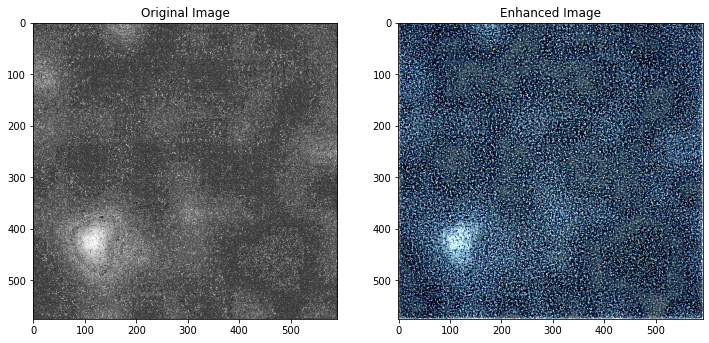

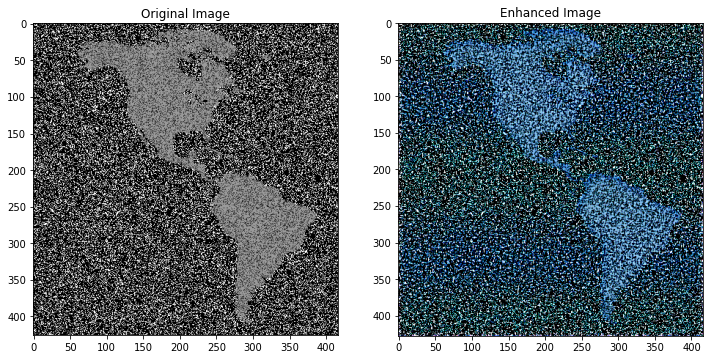

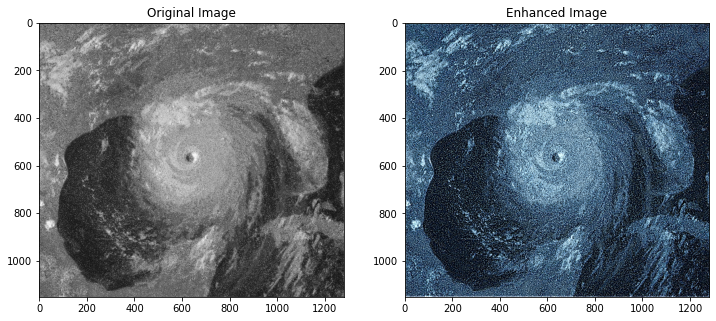

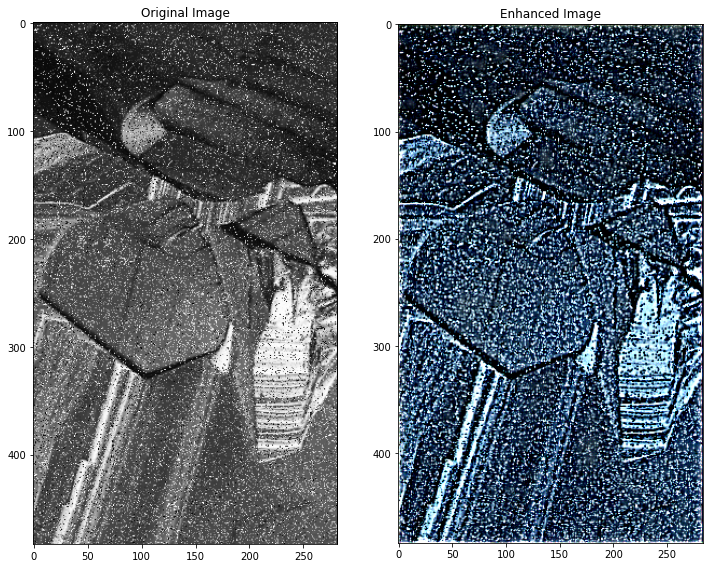

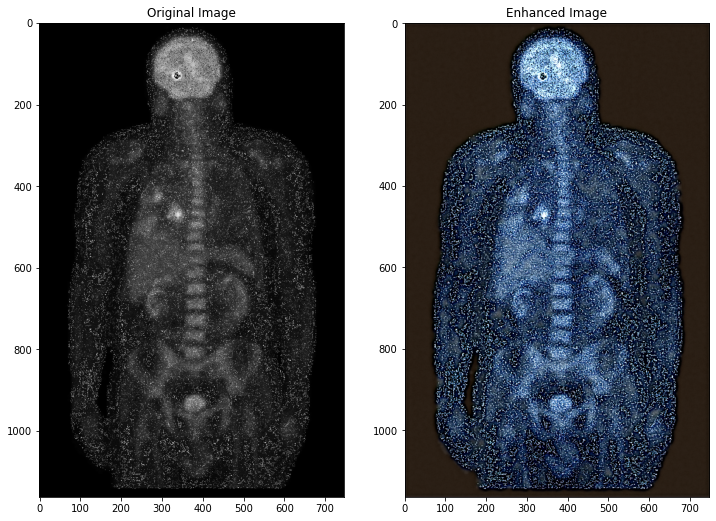

...

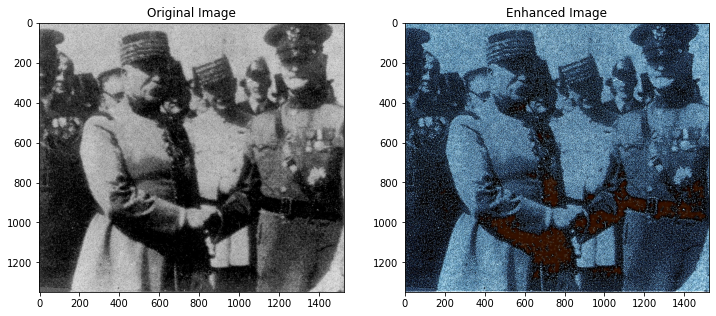

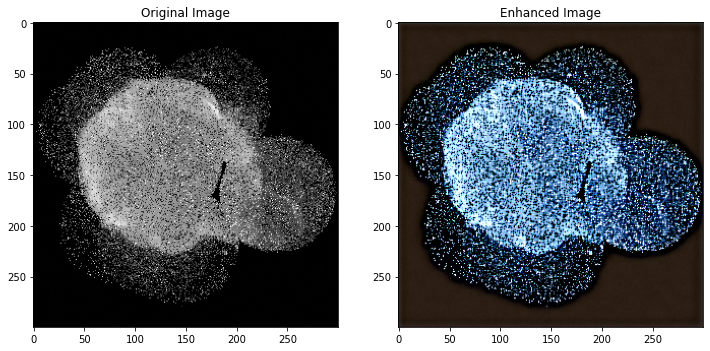

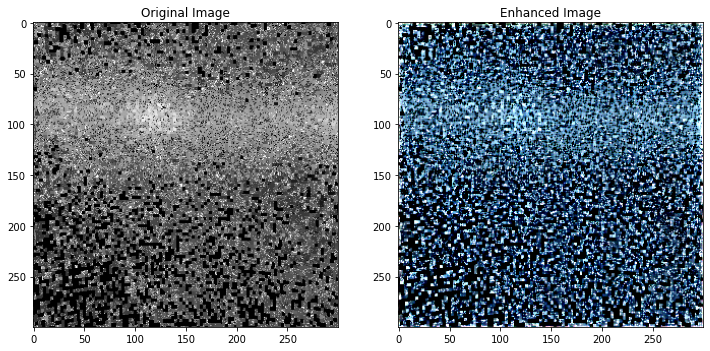

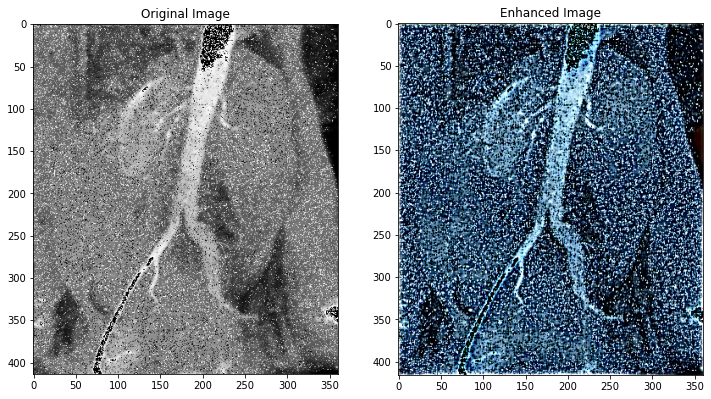

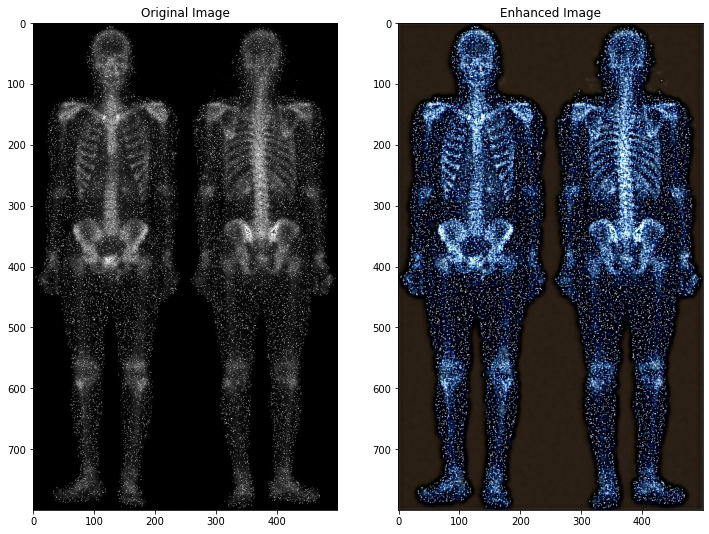

In [7]:
import cv2
noise_imgs = glob('/kaggle/input/img-bw-noise/*')
from PIL import Image
for img_path in noise_imgs:
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    img = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
    im_pil = Image.fromarray(img)
    original_image, output_image = inferer.infer_streamlit(im_pil)
    plot_result(original_image, output_image)

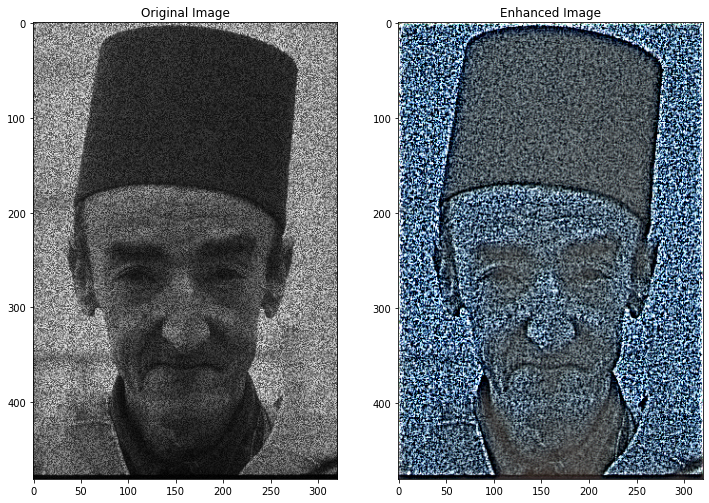

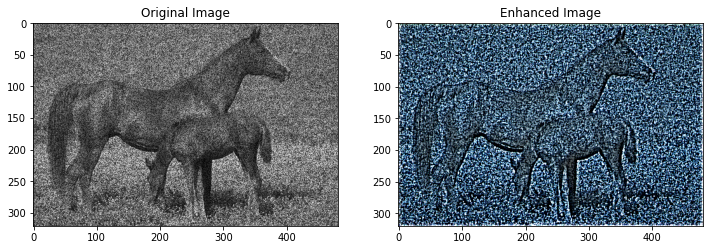

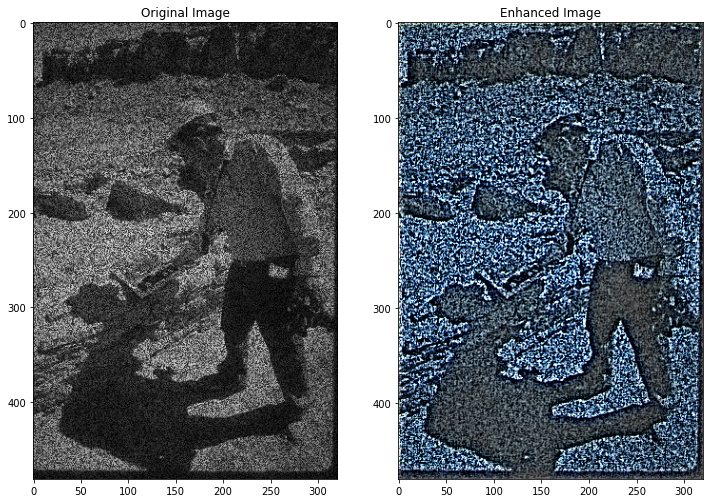

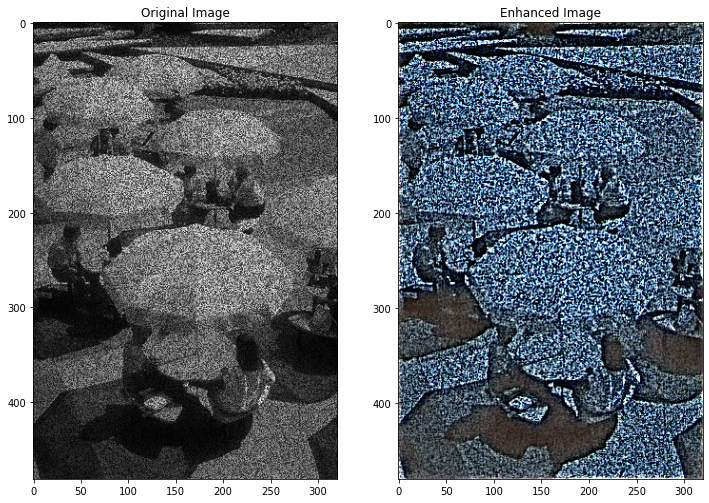

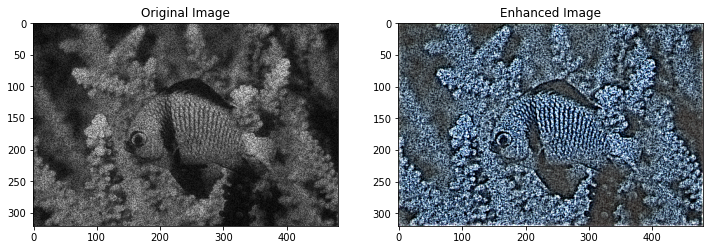

...

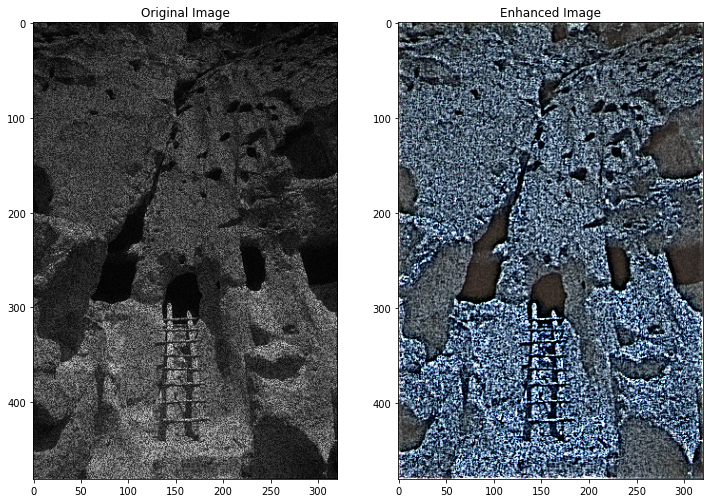

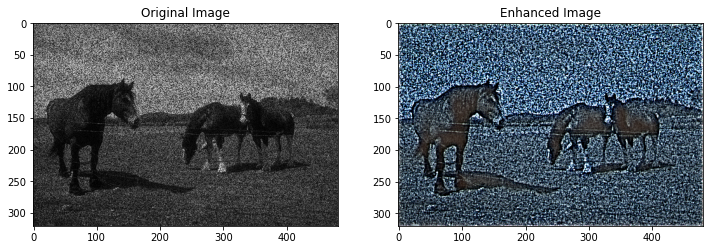

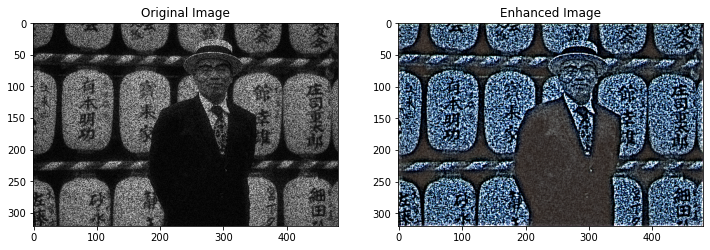

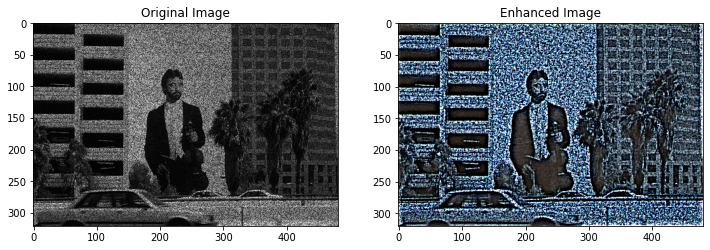

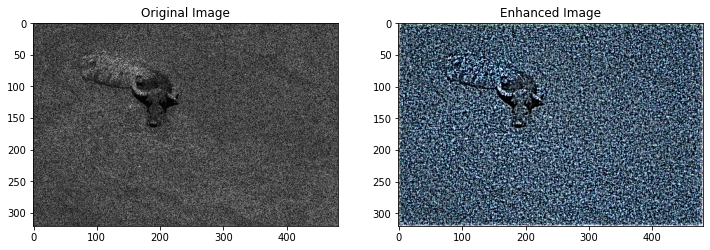

In [8]:
import cv2
import random
from PIL import Image
noise_imgs = glob('/kaggle/input/9-classes-noisy-image-dataset/dataset/train_im/speckle/*')
random.shuffle(noise_imgs)
for img_path in noise_imgs[:20]:
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    img = cv2.cvtColor(img,cv2.COLOR_GRAY2RGB)
    im_pil = Image.fromarray(img)
    original_image, output_image = inferer.infer_streamlit(im_pil)
    plot_result(original_image, output_image)

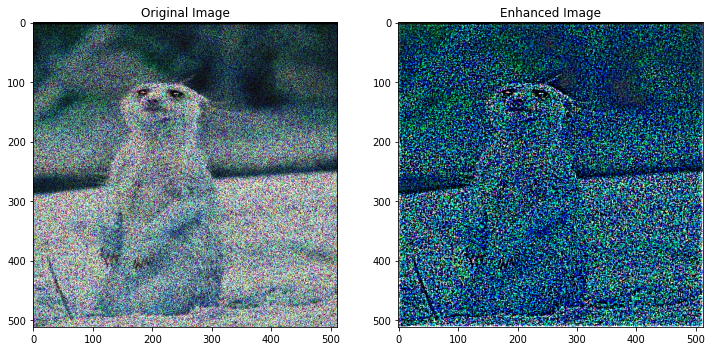

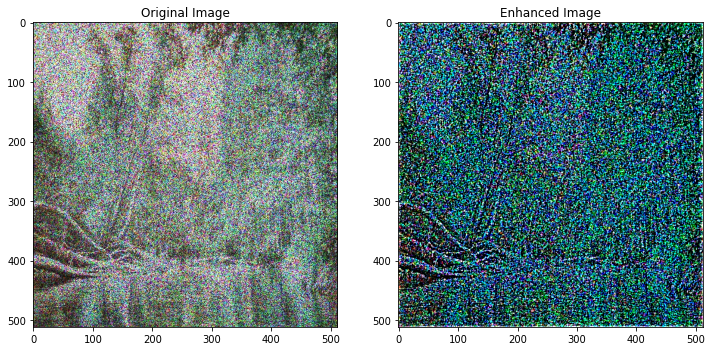

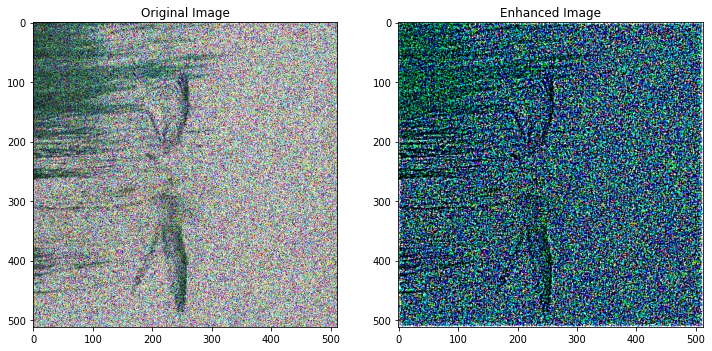

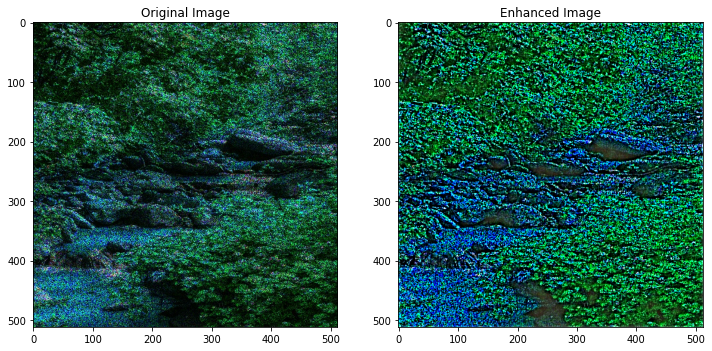

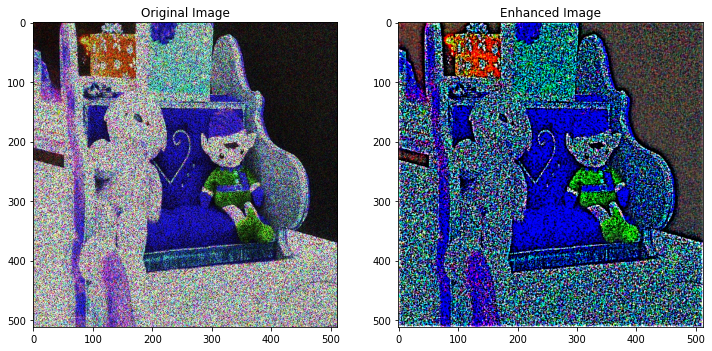

...

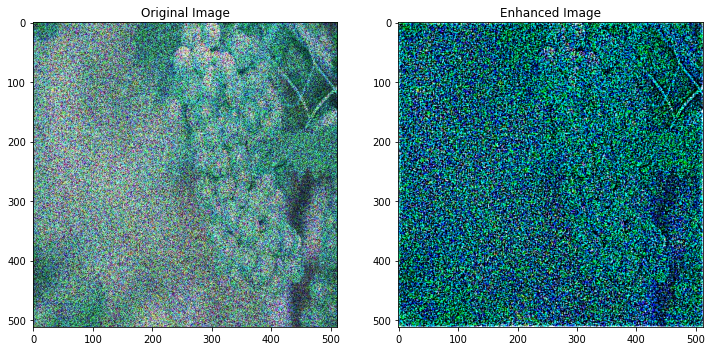

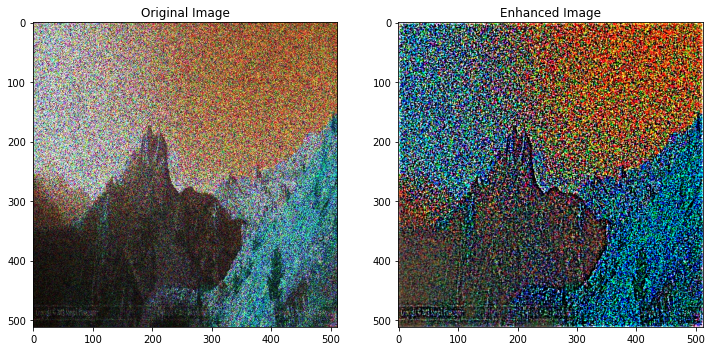

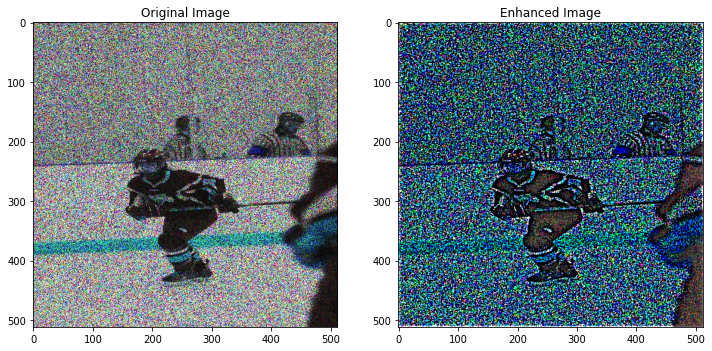

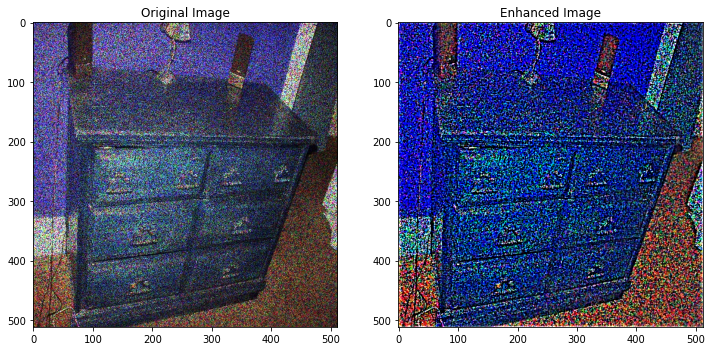

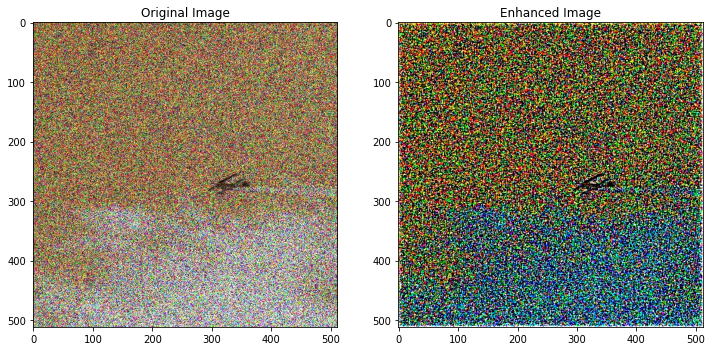

In [9]:
import cv2
import random
from PIL import Image
noise_imgs = glob('/kaggle/input/natural-images-with-synthetic-noise/train/train/noisy images/speckle*_c*')
random.shuffle(noise_imgs)
for img_path in noise_imgs[:20]:
    img = cv2.imread(img_path)
    im_pil = Image.fromarray(img)
    original_image, output_image = inferer.infer_streamlit(im_pil)
    plot_result(original_image, output_image)